<a href="https://colab.research.google.com/github/ektaarora3501/Neural-Networks/blob/master/DogVsCat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import tensorflow as tf
import cv2
import os,io,random
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg
import pandas as pd
from keras.layers import Conv2D,MaxPooling2D,Flatten,Dropout,Dense,Activation,GlobalAveragePooling2D
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import CSVLogger
#!pip install livelossplot
from livelossplot import PlotLossesKeras
from keras.models import Sequential
from keras.optimizers import RMSprop

In [195]:
from google.colab import drive
drive.mount('content',force_remount=True)

Mounted at content


In [196]:
!ls "content/My Drive/data/validation"

cats  dogs


cat.364.jpg
Shape of the image is: (500, 315, 3)
Max: 255 , Min: 0


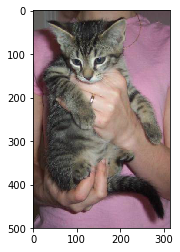

In [189]:
example_img = random.choice(os.listdir("content/My Drive/data/train/cats"))
print(example_img)
example_img = plt.imread("content/My Drive/data/train/cats/"+example_img)
plt.grid(False)
plt.imshow(example_img)
print("Shape of the image is:", example_img.shape)
print("Max:", example_img.max(), ", Min:", example_img.min())



dog.405.jpg
Shape of the image is: (500, 315, 3)
Max: 255 , Min: 0


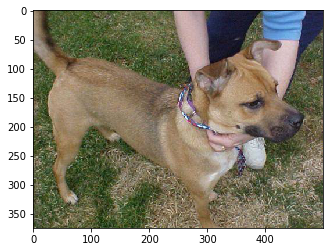

In [190]:
example_img2 = random.choice(os.listdir("content/My Drive/data/train/dogs"))
print(example_img2)
example_img2 = plt.imread("content/My Drive/data/train/dogs/"+example_img2)
plt.grid(False)
plt.imshow(example_img2)
print("Shape of the image is:", example_img.shape)
print("Max:", example_img.max(), ", Min:", example_img.min())

In [0]:
image_size=150
image_width,image_height=image_size,image_size
epochs=30
train_size=160
validation_sample=40
batch_size=16
test_size=30

input_shape=(image_width,image_height,3)

#using keras sequential model
train_path="content/My Drive/data/train"
test_path="content/My Drive/data/test"
valid_path="content/My Drive/data/validation"




In [0]:
model =Sequential()
model.add(Conv2D(32, (3, 3),border_mode='same', input_shape=input_shape, activation='relu'))
model.add(Conv2D(32,(3,3),border_mode='same',activation='relu'))  #inner layers with fewer filters 
model.add(MaxPooling2D(pool_size=(2,2)))

#outer layers to resolve more complex features have more filters
model.add(Conv2D(64, (3, 3),border_mode='same', activation='relu'))
model.add(Conv2D(64,(3,3),border_mode='same',activation='relu'))  #inner layers with fewer filters 
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(128, (3, 3),border_mode='same', activation='relu'))
model.add(Conv2D(128,(3,3),border_mode='same',activation='relu'))  #inner layers with fewer filters 
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(256, (3, 3),border_mode='same', input_shape=input_shape, activation='relu'))
model.add(Conv2D(256,(3,3),border_mode='same',activation='relu'))  #inner layers with fewer filters 
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Flatten())
model.add(Dense(256,activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(1))
model.add(Activation('sigmoid')) #final layer.. will be activated by sigmoid
    
  
model.compile(loss='binary_crossentropy',
              optimizer=RMSprop(lr=0.001),  #setting the learning rate
              metrics=['accuracy'])  #as there are two classes


In [0]:
train_data_gen=ImageDataGenerator(
         rescale=1./255,
         shear_range=0.1,
         zoom_range=0.1,
         horizontal_flip=True,
         
)

validation_data_gen=ImageDataGenerator(
  rescale=1./255,
 )

test_data_gen=ImageDataGenerator(
       rescale=1./255,     
)

validation_generator = validation_data_gen.flow_from_directory(
    valid_path,
    target_size=(image_width, image_height),
    batch_size=40,
    class_mode="binary")

training_generator = train_data_gen.flow_from_directory(
    train_path,
    target_size=(image_width, image_height),
    batch_size=train_size,
    class_mode="binary")

print(training_generator.class_indices)



test_generator = test_data_gen.flow_from_directory(
    test_path,
    target_size=(image_width, image_height),
    batch_size=30,
    class_mode="binary", 
    shuffle=False)

model.fit_generator(
    training_generator,
    steps_per_epoch=len(training_generator.filenames),
    epochs=epochs,
    validation_data=validation_generator,
    validation_steps=len(validation_generator.filenames),
    callbacks=[PlotLossesKeras()],verbose=1)

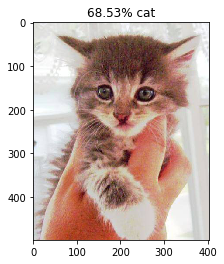

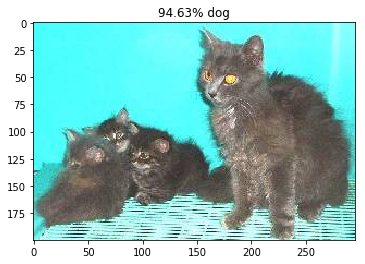

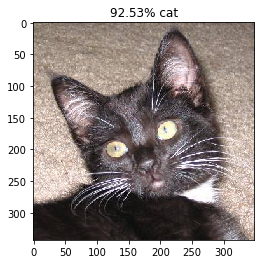

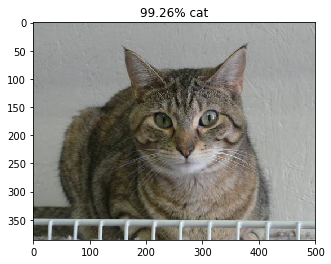

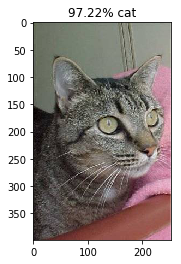

...

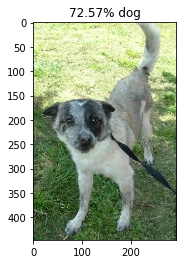

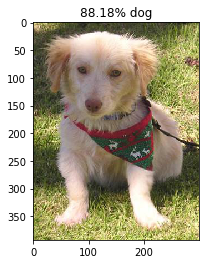

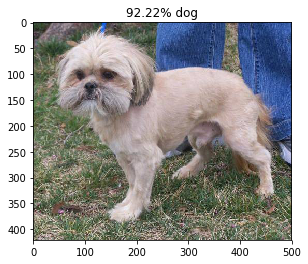

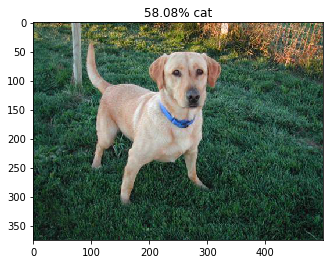

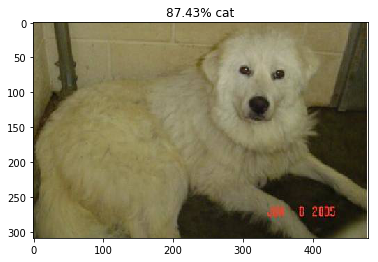

IndexError: ignored

In [197]:
probabilities = model.predict_generator(test_generator, test_size)
for index, probability in enumerate(probabilities):
    image_path = test_path + "/" +test_generator.filenames[index]
    img = mpimg.imread(image_path)
    plt.imshow(img)
    if probability > 0.5:
        plt.title("%.2f" % (probability[0]*100) + "% dog")
    else:
        plt.title("%.2f" % ((1-probability[0])*100) + "% cat")
    plt.show()
